In [1]:
%matplotlib inline

In [2]:
import os, math
import numpy as np
from pathlib import Path
import tifffile as tf
import base64
from IPython.display import Image, display
import json

import SimpleITK as sitk


import matplotlib
import matplotlib.pyplot as plt # Plotting

font = {'family' : 'serif',
        #'weight' : 'bold',
         'size'   : 12.5
       }
matplotlib.rc('font', **font)
# matplotlib.rc('text', usetex=True)

from skimage.metrics import structural_similarity as ssim
from sklearn.metrics import mean_absolute_percentage_error as mape

from gvxrPython3 import gvxr, json2gvxr
from gvxrPython3.utils import visualise
from gvxrPython3.utils import loadXpecgenSpectrum, loadSpekpySpectrum, has_xpecgen, has_spekpy
from gvxrPython3.JSON2gVXRDataReader import *

from utils import * # Code shared across more than one notebook

from cil.utilities.jupyter import islicer
from cil.processors import TransmissionAbsorptionConverter
from cil.utilities.display import show_geometry, show2D
from cil.recon import FBP, FDK

astropy module not found


SimpleGVXR 2.0.4 (2023-01-18T09:50:01) [Compiler: GNU g++] on Linux
gVirtualXRay core library (gvxr) 2.0.4 (2023-01-18T09:50:00) [Compiler: GNU g++] on Linux


In [3]:
def saveJSON(fname):
    with open(fname, "w") as outfile:
        json.dump(json2gvxr.params, outfile, indent = 4)

In [4]:
def runScan():
    
    # Get the path where the projections are
    # output_path = json2gvxr.getFilePath(json2gvxr.params["Scan"]["OutFolder"])
    output_projection_path = json2gvxr.params["Scan"]["OutFolder"]

    if not os.path.exists(output_projection_path):
        os.makedirs(output_projection_path)

    # Simulate the projections
    angles = json2gvxr.doCTScan(verbose=False)

    # Save angles to file
    with open(output_path + "/angles.csv", "w") as f:
        f.writelines([ f"{x}\n" for x in angles])    

In [5]:
def saveReconstruction(fname, reconstruction):
    image = sitk.GetImageFromArray(reconstruction.as_array())
    # image.SetOrigin((0, 0, 0))
    image.SetSpacing([pixel_spacing[0], pixel_spacing[0], pixel_spacing[1]])
    writer = sitk.ImageFileWriter()
    writer.SetFileName(fname)
    writer.Execute(image)    

In [6]:
def reconstruct(JSON_fname):
    
    reader = JSON2gVXRDataReader(file_name=JSON_fname)
    data = reader.read()

    data.reorder(order='tigre')
    data_corr = TransmissionAbsorptionConverter(white_level=data.max())(data)

    ig = data.geometry.get_ImageGeometry()

    ig.voxel_num_x = ref_size[0]
    ig.voxel_num_y = ref_size[1]
    ig.voxel_num_z = ref_size[2]

    source_shape = json2gvxr.params["Source"]["Shape"]

    if type(source_shape) == str:

        if source_shape.upper() == "PARALLELBEAM" or source_shape.upper() == "PARALLEL":
            reconstruction = FBP(data_corr, ig).run()

        elif source_shape.upper() == "POINTSOURCE" or source_shape.upper() == "POINT" or source_shape.upper() == "CONE" or source_shape.upper() == "CONEBEAM":
            reconstruction = FDK(data_corr, ig).run()

        else:
            raise ValueError("Unknown source shape:" + source_shape)

    elif type(source_shape) == type([]):
        if source_shape[0].upper() == "FOCALSPOT":
            reconstruction = FDK(data_corr, ig).run()

        else:
            raise ValueError("Unknown source shape:" + source_shape)

    else:
        raise ValueError("Unknown source shape:" + source_shape)    
        
    return data, reconstruction

In [7]:
output_path = "4-output_data_CT_lungman/"

if not os.path.exists(output_path):
    os.mkdir(output_path)

In [8]:
reader = sitk.ImageFileReader()
# reader.SetImageIO("GDCMImageIO")
reader.SetFileName("lungman_data/lungman.mha")
reader.LoadPrivateTagsOn()
reader.ReadImageInformation()    
ref_volume = reader.Execute()
ref_size = ref_volume.GetSize()
real_CT_in_HU = sitk.GetArrayFromImage(ref_volume)
del ref_volume

In [9]:
reader = sitk.ImageFileReader()
reader.SetImageIO("GDCMImageIO")
reader.LoadPrivateTagsOn()

reader.SetFileName("lungman_data/CT/DICOM/ST000000/SE000000/CT000000")
reader.ReadImageInformation()    
volume1 = reader.Execute()

reader.SetFileName("lungman_data/CT/DICOM/ST000000/SE000000/CT000001")
reader.ReadImageInformation()    
volume2 = reader.Execute()

In [10]:
kvp = int(volume1.GetMetaData("0018|0060"))
exposure_time = int(volume1.GetMetaData("0018|1150"))
xray_tube_current = int(volume1.GetMetaData("0018|1151"))
exposure = int(volume1.GetMetaData("0018|1152"))
distance_source_to_detector = float(volume1.GetMetaData("0018|1110"))
distance_source_to_patient = float(volume1.GetMetaData("0018|1111"))
pixel_spacing = np.array(volume1.GetMetaData("0028|0030").split("\\")).astype(np.single).tolist()
size = volume1.GetSize()
rows = int(volume1.GetMetaData("0028|0010"))
columns = int(volume1.GetMetaData("0028|0011"))
slice_thickness = float(volume1.GetMetaData("0018|0050"))

print("kVp:", kvp)
print("Exposure time (in msec):", exposure_time)
print("X-ray Tube Current (in mA):", xray_tube_current)
print("Exposure (in mAs):", exposure)
print("Distance Source to Detector (in mm):", distance_source_to_detector)
print("Distance Source to Patient (in mm):", distance_source_to_patient)
print("Pixel Spacing (in mm): ", pixel_spacing)
print("Slice Thickness (in mm): ", slice_thickness)
print("Image size (in px): ", str(columns) + "x" + str(rows))

slice_location_1 = float(volume1.GetMetaData("0020|1041"))
slice_location_2 = float(volume2.GetMetaData("0020|1041"))
slice_thickness = abs(slice_location_2 - slice_location_1)
print("Corrected slice Thickness (in mm): ", slice_thickness)

kVp: 100
Exposure time (in msec): 285
X-ray Tube Current (in mA): 128
Exposure (in mAs): 60
Distance Source to Detector (in mm): 1085.6
Distance Source to Patient (in mm): 595.0
Pixel Spacing (in mm):  [0.625, 0.625]
Slice Thickness (in mm):  1.0
Image size (in px):  512x512
Corrected slice Thickness (in mm):  0.700000000000017


In [11]:
JSON_fname = "notebook-lungman-CT.json"
file_abs_path = os.path.abspath(JSON_fname)
dir_path = os.path.dirname(file_abs_path)

In [12]:
diagonal = 1 + round(math.sqrt(math.pow(columns * pixel_spacing[0], 2) + math.pow(rows * pixel_spacing[1], 2)) / pixel_spacing[0])

if diagonal % 2 == 0:
    diagonal + 1

In [13]:
json2gvxr.initGVXR(JSON_fname, "OPENGL")


json2gvxr.params["Detector"]["Position"] = [0, -50, 0, "cm"]
json2gvxr.params["Detector"]["UpVector"] =  [0, 0, -1]
json2gvxr.params["Detector"]["NumberOfPixels"] = [diagonal, rows]
json2gvxr.params["Detector"]["Spacing"] = [pixel_spacing[0], slice_thickness, "mm"]

json2gvxr.initDetector()


json2gvxr.params["Source"]["Position"] = [0, 50, 0, "cm"]
json2gvxr.params["Source"]["Shape"] = "Parallel"

json2gvxr.initSourceGeometry()

json2gvxr.params["Source"]["Beam"] = {}
json2gvxr.params["Source"]["Beam"]["kvp"] = kvp
json2gvxr.params["Source"]["Beam"]["tube angle"] = 12
json2gvxr.params["Source"]["Beam"]["filter"] = [["Al", 2.5]]

# json2gvxr.params["Source"]["Beam"] = [{}]
# json2gvxr.params["Source"]["Beam"][0]["Energy"] = 72
# json2gvxr.params["Source"]["Beam"][0]["Unit"] = "keV"
# json2gvxr.params["Source"]["Beam"][0]["PhotonCount"] = 1.0
    
spectrum =json2gvxr.initSpectrum(verbose=0);

Create an OpenGL context: 450x450
Set up the detector
	Detector position: [0, -50, 0, 'cm']
	Detector up vector: [0, 0, -1]
	Number of pixels: [725, 512]
	Detector number of pixels: [725, 512]
	Pixel spacing: [0.625, 0.700000000000017, 'mm']
Set up the beam
	Source position: [0, 50, 0, 'cm']
	Source shape: Parallel


Wed Jan 18 12:56:35 2023 ---- Create window (ID: -1)
Wed Jan 18 12:56:35 2023 ---- Initialise GLFW
Wed Jan 18 12:56:35 2023 ---- Create an OpenGL window with a 3.2 context.
Wed Jan 18 12:56:35 2023 ---- Make the window's context current
Wed Jan 18 12:56:35 2023 ---- Initialise GLEW
Wed Jan 18 12:56:35 2023 ---- OpenGL vendor: NVIDIA Corporation
Wed Jan 18 12:56:35 2023 ---- OpenGL renderer: NVIDIA GeForce RTX 2080 Ti/PCIe/SSE2
Wed Jan 18 12:56:35 2023 ---- OpenGL version: 3.2.0 NVIDIA 525.60.13
Wed Jan 18 12:56:35 2023 ---- Use OpenGL 4.5.
Wed Jan 18 12:56:35 2023 ---- Initialise the X-ray renderer if needed and if possible
Wed Jan 18 12:56:38 2023 ---- Initialise the renderer


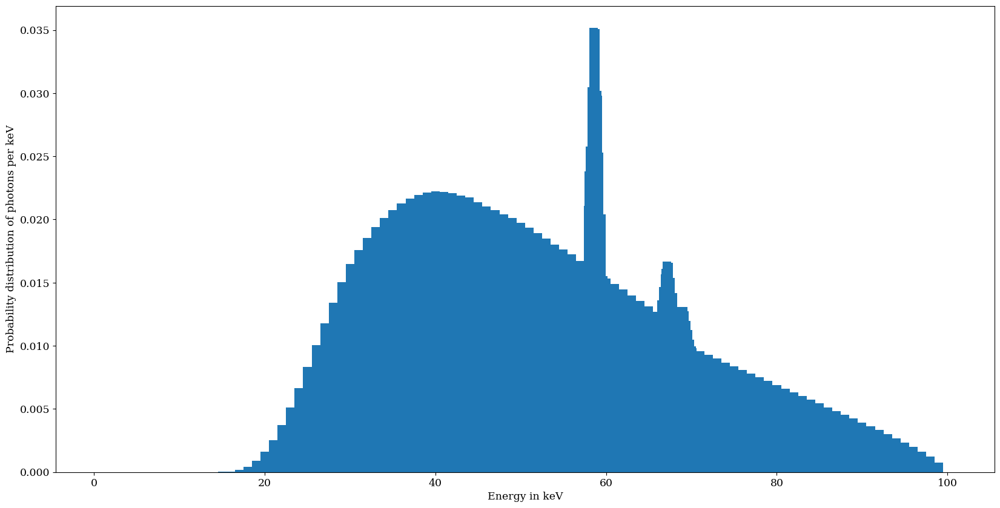

In [14]:
plt.figure(figsize= (20,10))
plt.bar(spectrum[2], spectrum[3], width=1)
plt.xlabel('Energy in keV')
plt.ylabel('Probability distribution of photons per keV')
plt.savefig(output_path + "/lungman-CT-spectrum.pdf")

In [15]:
temp_JSON_fname = "temp.json"
fname = output_path + "/CT_water_in_HU.mha"

if os.path.exists(fname):
    sitk_image = sitk.ReadImage(fname)
    temp_CT = sitk.GetArrayFromImage(sitk_image)
    del sitk_image
    
else:
    gvxr.makeCube("water", 10, "cm")
    gvxr.setCompound("water", "H2O")
    gvxr.setDensity("water", 1.0, "g/cm3")
    gvxr.addPolygonMeshAsInnerSurface("water")
    
    json2gvxr.initScan()
    gvxr.computeXRayImage()
    gvxr.displayScene()
    
    runScan()
    
    saveJSON(temp_JSON_fname)
    
    data, reconstruction = reconstruct(temp_JSON_fname)
    
    saveReconstruction(output_path + "/CT_water_in_HU.mha", reconstruction)
    temp_CT = reconstruction.as_array()
    
    del data
    del reconstruction

In [16]:
cube_length = 180
x_min = 0 + cube_length
y_min = 0 + cube_length
z_min = 142

x_max = 512 - cube_length - 1
y_max = 512 - cube_length - 1
z_max = 282 - 1

water_box_mu = temp_CT[z_min:z_max, y_min:y_max, x_min:x_max]
mu_water = np.mean(water_box_mu)

del temp_CT
del water_box_mu

In [17]:
json2gvxr.initSamples()

skin_bbox = gvxr.getNodeOnlyBoundingBox("Skin", "mm")

json2gvxr.params["Detector"]["Position"] = [(skin_bbox[0] + skin_bbox[3]) / 2, 
                                            (skin_bbox[1] + distance_source_to_patient - distance_source_to_detector), 
                                            (skin_bbox[2] + skin_bbox[5]) / 2, 
                                            "mm"]
json2gvxr.initDetector()



json2gvxr.params["Source"]["Position"] = [(skin_bbox[0] + skin_bbox[3]) / 2, 
                                          (distance_source_to_detector + skin_bbox[1] + distance_source_to_patient - distance_source_to_detector), 
                                          (skin_bbox[2] + skin_bbox[5]) / 2, 
                                          "mm"]

Wed Jan 18 12:56:40 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/bronchioles.stl	nb_faces:	5338192	nb_vertices:	16014576	bounding_box (in cm):	(

Set up the detector
	Detector position: [0.0, -608.0999999999999, 0.0, 'mm']
	Detector up vector: [0, 0, -1]
	Number of pixels: [725, 512]
	Detector number of pixels: [725, 512]
	Pixel spacing: [0.625, 0.700000000000017, 'mm']


-12.625, -8.3125, -13.65)	(11.8125, 7.3125, 12.81)
Wed Jan 18 12:56:40 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/bronchus.stl	nb_faces:	701200	nb_vertices:	2103600	bounding_box (in cm):	(-11.375, -8.0625, -11.97)	(11.75, 6.5, 10.57)
Wed Jan 18 12:56:40 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/trachea.stl	nb_faces:	88328	nb_vertices:	264984	bounding_box (in cm):	(-2.8125, -6.625, -1.68)	(3.8125, 0.5, 14.84)
Wed Jan 18 12:56:40 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/diaphram.stl	nb_faces:	507436	nb_vertices:	1522308	bounding_box (in cm):	(-12.625, -9, -14.84)	(11.875, 6.3125, -8.26)
Wed Jan 18 12:56:41 2023 ---- file_name:	/home/franck/PROGRAMMING/GitHub/gvxr-validation/lungman_data/meshes/skin.stl	nb_faces:	6422456	nb_vertices:	19267368	bounding_box (in cm):	(-15.9375, -11.75, -14.84)	(15.9375, 10.75, 14.84)
Wed Jan 18 12:56:41 2023 ---- file_n

In [18]:
json2gvxr.initScan()
gvxr.computeXRayImage()
gvxr.displayScene()

Set up the CT Scan


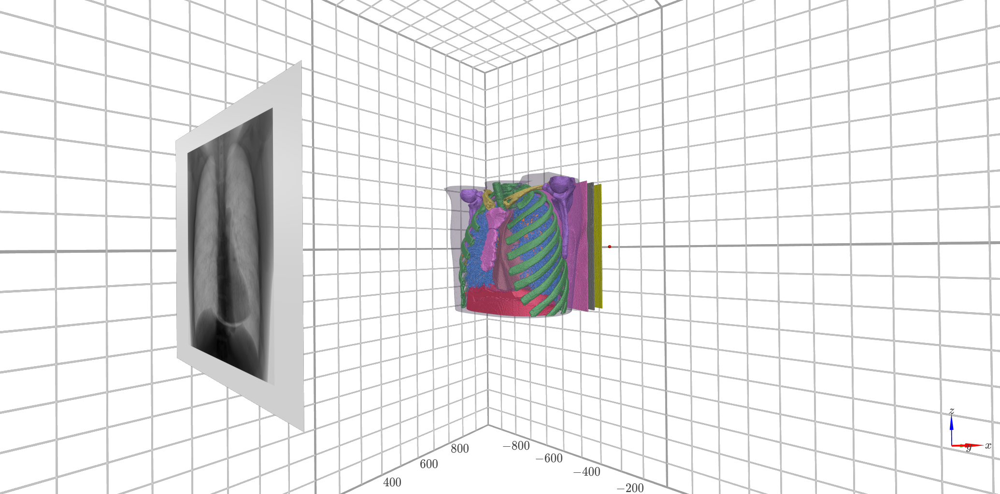

In [19]:
fname = output_path + "/visualisation.png"

if os.path.exists(fname):
    display(Image(fname, width=1000))
else:
    plot = visualise(use_log=True)
    plot.display()

In [20]:
if not os.path.exists(fname):
    if plot is not None:
        plot.fetch_screenshot()

        data = base64.b64decode(plot.screenshot)
        with open(fname,'wb') as fp:
            fp.write(data)

In [21]:
runScan()

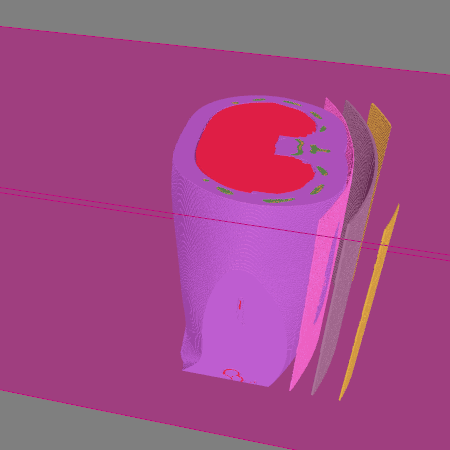

In [22]:
# gif_fname = json2gvxr.getFilePath(json2gvxr.params["Scan"]["GifPath"])
if "GifPath" in json2gvxr.params["Scan"]:
    gif_fname = json2gvxr.params["Scan"]["GifPath"]

    with open(gif_fname,'rb') as f:
        display(Image(data=f.read(), format='png', width=1000))

In [24]:
saveJSON(temp_JSON_fname)
data, reconstruction = reconstruct(temp_JSON_fname)
saveReconstruction(output_path + "/lungman-simulated_CT_in_mu.mha", reconstruction)

[0. 1. 0.]
[ -0.  608.1  -0. ]
[0, 0, 0]
[ 0  0 -1]
[725, 512]
[0.625, 0.700000000000017]
FBP recon

Input Data:
	angle: 1901
	vertical: 512
	horizontal: 725

Reconstruction Volume:
	vertical: 426
	horizontal_y: 512
	horizontal_x: 512

Reconstruction Options:
	Backend: tigre
	Filter: ram-lak
	FFT order: 11
	Filter_inplace: False
	Split processing: 0

Reconstructing in 1 chunk(s):



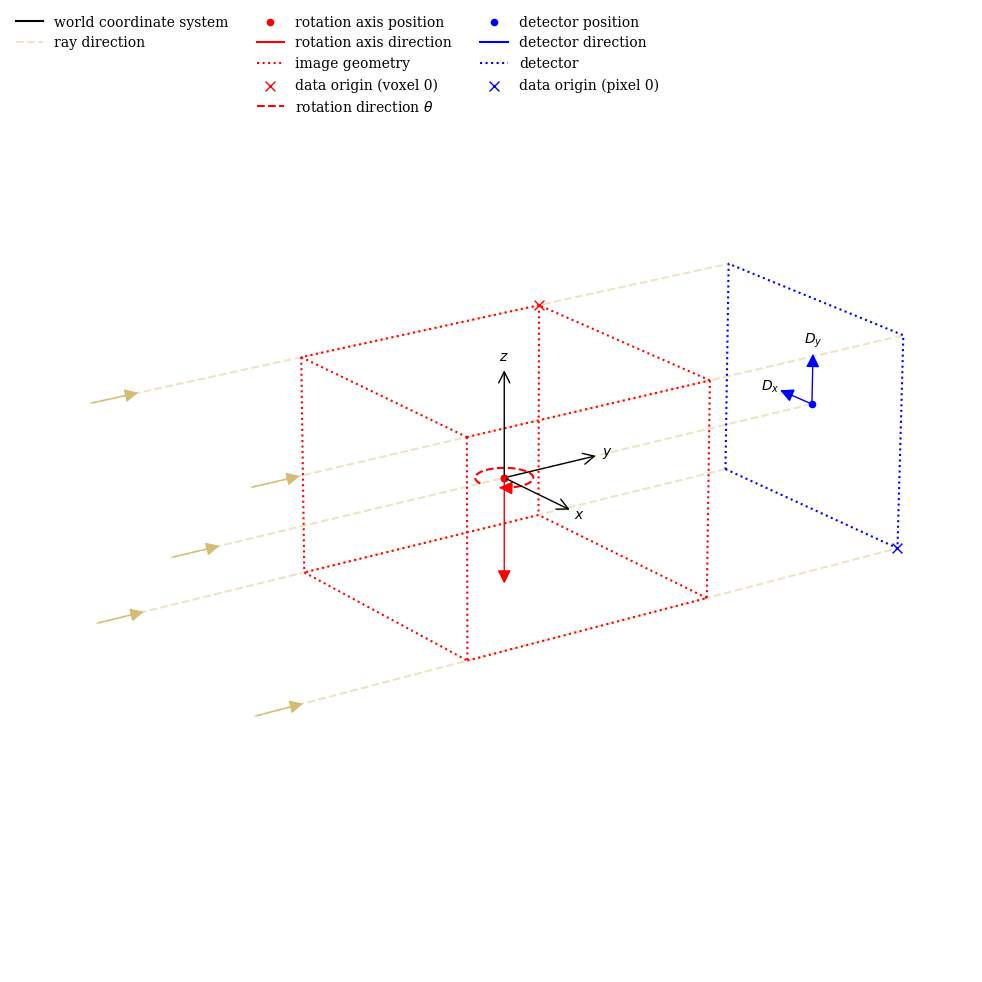

In [25]:
show_geometry(data.geometry)

In [26]:
islicer(reconstruction, direction='vertical')

interactive(children=(IntSlider(value=213, continuous_update=False, description='vertical', max=425), FloatRan…

IntSlider(value=213, continuous_update=False, description='vertical', max=425)

In [27]:
islicer(reconstruction, direction='horizontal_x')

interactive(children=(IntSlider(value=256, continuous_update=False, description='horizontal_x', max=511), Floa…

IntSlider(value=256, continuous_update=False, description='horizontal_x', max=511)

In [28]:
mu_air = 0
simulated_CT_in_HU = np.array(1000 * (reconstruction.as_array() - mu_water) / (mu_water - mu_air), dtype=np.int16)

In [29]:
fname = output_path + "/lungman-simulated_CT_in_HU.mha"

if True:#not os.path.exists(fname):
    
    sitk_image = sitk.GetImageFromArray(simulated_CT_in_HU)
    sitk_image.SetSpacing([pixel_spacing[0], pixel_spacing[0], slice_thickness])
    sitk.WriteImage(sitk_image, fname, useCompression=True)
    
    del sitk_image

In [30]:
flipped_volume = np.flip(simulated_CT_in_HU, axis=2)

In [31]:
slice_id = real_CT_in_HU.shape[0] // 2
# slice_id = 403
# last_row = 400

first_slice_ref = real_CT_in_HU[1].astype(float)
first_slice_test = flipped_volume[1].astype(float)

MAPE = mape(first_slice_ref, first_slice_test)
ZNCC = np.mean((first_slice_ref - first_slice_ref.mean()) / first_slice_ref.std() * (first_slice_test - first_slice_test.mean()) / first_slice_test.std())
SSIM = ssim(first_slice_ref, first_slice_test, data_range=first_slice_ref.max() - first_slice_ref.min())

print("ZNCC:", "{0:0.2f}".format(100 * ZNCC) + "%")
print("SSIM:", "{0:0.2f}".format(SSIM))




middle_slice_ref = real_CT_in_HU[slice_id].astype(float)
middle_slice_test = flipped_volume[slice_id].astype(float)

MAPE = mape(middle_slice_ref, middle_slice_test)
ZNCC = np.mean((middle_slice_ref - middle_slice_ref.mean()) / middle_slice_ref.std() * (middle_slice_test - middle_slice_test.mean()) / middle_slice_test.std())
SSIM = ssim(middle_slice_ref, middle_slice_test, data_range=middle_slice_ref.max() - middle_slice_ref.min())

print("ZNCC:", "{0:0.2f}".format(100 * ZNCC) + "%")
print("SSIM:", "{0:0.2f}".format(SSIM))


last_slice_ref = real_CT_in_HU[real_CT_in_HU.shape[0] - 2].astype(float)
last_slice_test = flipped_volume[real_CT_in_HU.shape[0] - 2].astype(float)

MAPE = mape(last_slice_ref, last_slice_test)
ZNCC = np.mean((last_slice_ref - last_slice_ref.mean()) / last_slice_ref.std() * (last_slice_test - last_slice_test.mean()) / last_slice_test.std())
SSIM = ssim(last_slice_ref, last_slice_test, data_range=last_slice_ref.max() - last_slice_ref.min())

print("ZNCC:", "{0:0.2f}".format(100 * ZNCC) + "%")
print("SSIM:", "{0:0.2f}".format(SSIM))

ZNCC: 98.96%
SSIM: 0.57
ZNCC: 98.44%
SSIM: 0.75
ZNCC: 99.04%
SSIM: 0.78


In [32]:
def plotProfiles(ref, test, fname):
    ground_truth_diag = np.diag(ref)
    gvxr_diag = np.diag(test)

    x = np.linspace(0, len(ground_truth_diag), len(ground_truth_diag)) * pixel_spacing[0]
    plt.figure(figsize=(15, 5))

    ax = plt.subplot(111)

    ax.set_title("Diagonal profiles")

    ax.plot(x, ground_truth_diag, label="Ground truth (real CT)")
    ax.plot(x, gvxr_diag, label="CT reconstructed from data simulated with gVirtualXray")

    ax.legend(loc='best',
              ncol=1, fancybox=True, shadow=True)

    plt.xlabel("Pixel position (in mm)")
    plt.ylabel("Pixel intensity")

    plt.savefig(fname + '.pdf')
    plt.savefig(fname + '.png')

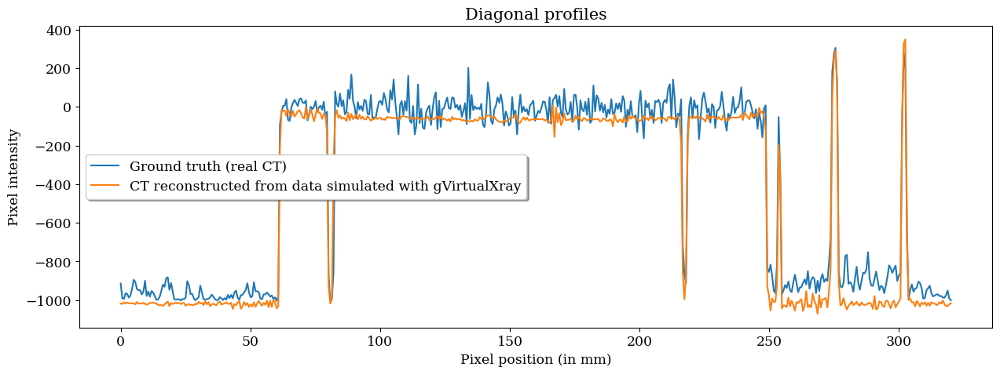

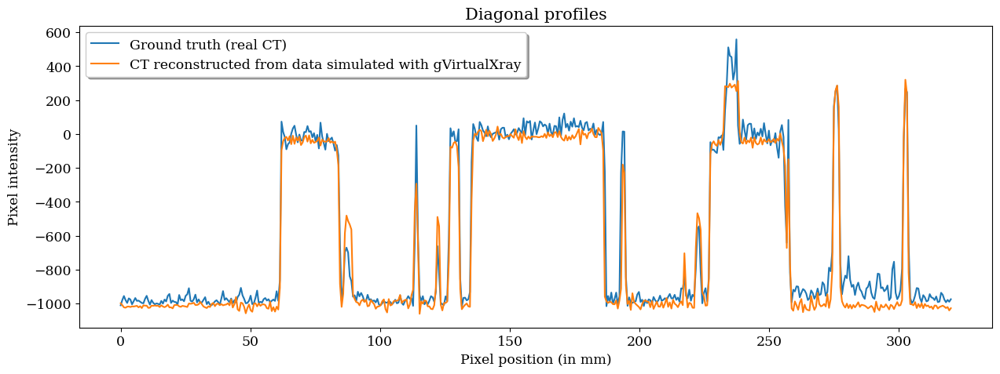

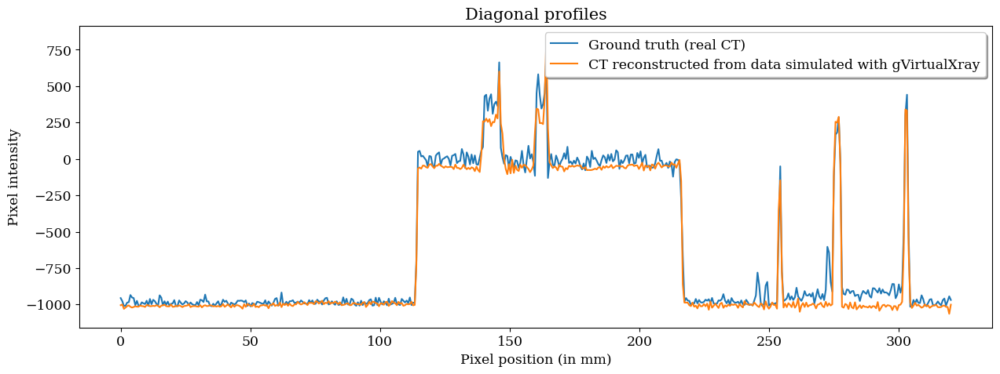

In [33]:
plotProfiles(first_slice_ref,  first_slice_test,  output_path + '/profiles-lungman_CT-first_slice')
plotProfiles(middle_slice_ref, middle_slice_test, output_path + '/profiles-lungman_CT-middle_slice')
plotProfiles(last_slice_ref,   last_slice_test,   output_path + '/profiles-lungman_CT-last_slice')

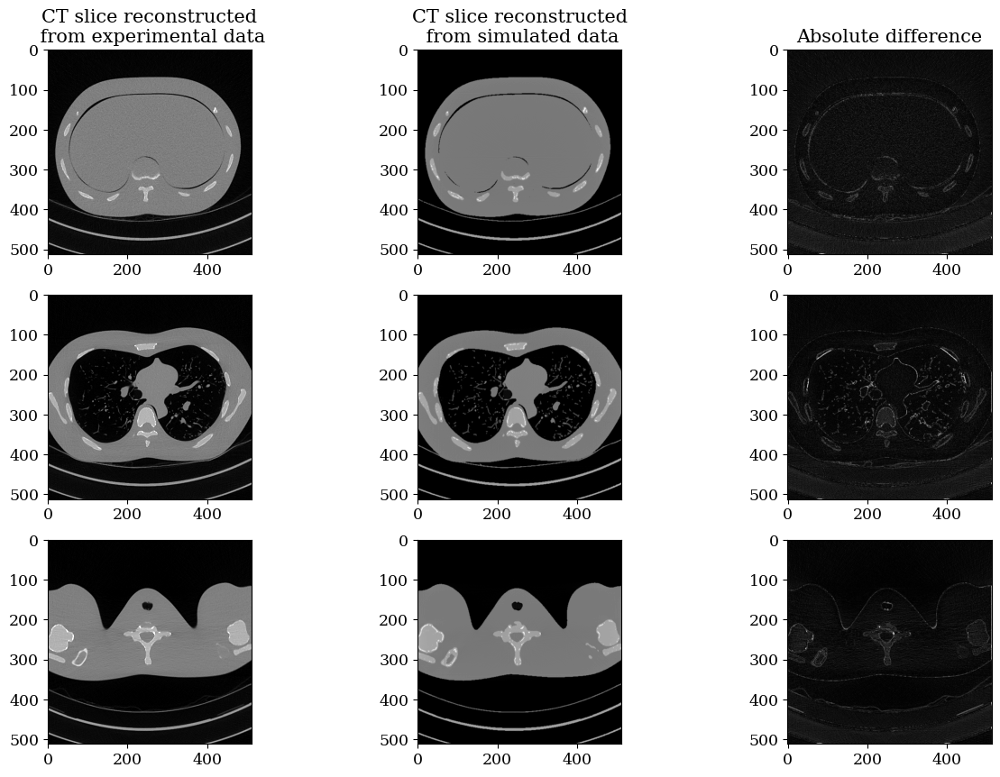

In [34]:
fig, axs = plt.subplots(3, 3, figsize=(15,10))

axs[0,0].imshow(first_slice_ref, cmap="gray", vmin=-1000, vmax=1000)
axs[0,1].imshow(first_slice_test, cmap="gray", vmin=-1000, vmax=1000)
axs[0,2].imshow(np.abs(first_slice_ref - first_slice_test), cmap="gray", vmin=0, vmax=1000)

axs[1,0].imshow(middle_slice_ref, cmap="gray", vmin=-1000, vmax=1000)
axs[1,1].imshow(middle_slice_test, cmap="gray", vmin=-1000, vmax=1000)
axs[1,2].imshow(np.abs(middle_slice_ref - middle_slice_test), cmap="gray", vmin=0, vmax=1000)

axs[2,0].imshow(last_slice_ref, cmap="gray", vmin=-1000, vmax=1000)
axs[2,1].imshow(last_slice_test, cmap="gray", vmin=-1000, vmax=1000)
axs[2,2].imshow(np.abs(last_slice_ref - last_slice_test), cmap="gray", vmin=0, vmax=1000)

axs[0,0].set_title("CT slice reconstructed\n from experimental data")
axs[0,1].set_title("CT slice reconstructed\n from simulated data")
axs[0,2].set_title("Absolute difference")


plt.savefig(output_path + "/CT_slices.png")

In [35]:
gvxr.terminate()

Wed Jan 18 13:06:07 2023 ---- Destroy all the windows
Wed Jan 18 13:06:08 2023 ---- Destroy window 0(0x55c5257276a0)


In [36]:
os.remove(temp_JSON_fname)
